In [30]:
import os
import torch
import torch.nn as nn
import torch.nn.functional as F
import torch.optim as optim
import torchvision.transforms as transforms
import torchvision.datasets as datasets
from torch.utils.data import DataLoader
from torchvision.utils import make_grid
import matplotlib.pyplot as plt
import numpy as np
from PIL import Image
import cv2
from model import SimpsonCNN
from torch.optim import Adam
from torch.nn import CrossEntropyLoss
from collections import Counter
import shutil
from sklearn.metrics import classification_report
from torch.utils.data import random_split
import copy
from torchvision.models import resnet18
import torch.nn as nn
from datetime import datetime
from torch.optim.lr_scheduler import ReduceLROnPlateau
import seaborn as sns
from sklearn.metrics import confusion_matrix
from torch.utils.data import WeightedRandomSampler
from torch.optim.lr_scheduler import ReduceLROnPlateau
from torchvision.models import resnet50, ResNet50_Weights
from torch.nn import CrossEntropyLoss
from torch.utils.data import random_split


device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
print("Dispositivo:", device)


Dispositivo: cuda


In [5]:
# Directorio con las imágenes organizadas por carpetas de personaje
DATA_DIR = "data/simpsons_dataset"

# Hiperparámetros
BATCH_SIZE = 32
EPOCHS = 10
LEARNING_RATE = 0.001
IMG_SIZE = 128
NUM_CLASSES = 10  # Puedes ajustar este valor si tienes más clases


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.9607843].


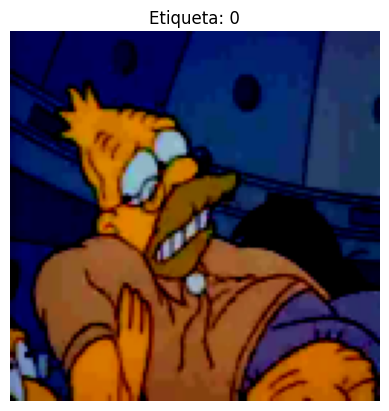

In [6]:
# Configuraciones
DATA_DIR = "../data/simpsons_dataset"
IMG_SIZE = 128

# Transformaciones
transform = transforms.Compose([
    transforms.Resize((IMG_SIZE, IMG_SIZE)),  # Redimensiona todas a tamaño uniforme
    transforms.ToTensor(),
    transforms.Normalize((0.5,), (0.5,))
])

# Dataset de imágenes
from torchvision.datasets import ImageFolder
dataset = ImageFolder(DATA_DIR, transform=transform)

# Visualiza ejemplo
img, label = dataset[0]
plt.imshow(img.permute(1, 2, 0))  # De [C, H, W] a [H, W, C]
plt.title(f"Etiqueta: {label}")
plt.axis("off")
plt.show()


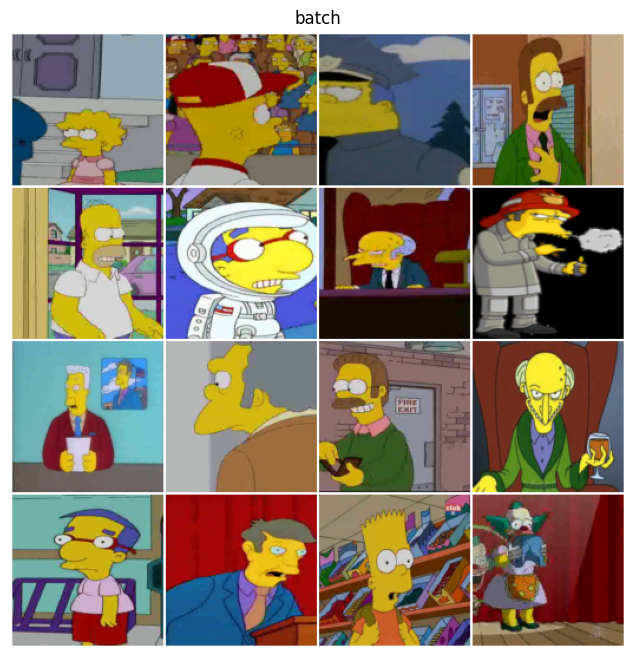

In [7]:
# Configurar DataLoader
BATCH_SIZE = 32

dataloader = DataLoader(dataset, batch_size=BATCH_SIZE, shuffle=True)

# Mostrar un batch de imágenes
def mostrar_batch(dataloader):
    images, labels = next(iter(dataloader))
    grid = make_grid(images[:16], nrow=4, normalize=True, pad_value=1)
    plt.figure(figsize=(8, 8))
    plt.imshow(grid.permute(1, 2, 0))  # [C, H, W] → [H, W, C]
    plt.axis("off")
    plt.title("batch")
    plt.show()

mostrar_batch(dataloader)


In [8]:
# Mostrar cuántas imágenes hay por clase
conteo_por_clase = Counter()
for clase in os.listdir(DATA_DIR):
    ruta_clase = os.path.join(DATA_DIR, clase)
    if os.path.isdir(ruta_clase):
        conteo_por_clase[clase] = len(os.listdir(ruta_clase))

# Mostrar clases con menos de 20 imágenes
for clase, cantidad in conteo_por_clase.items():
    if cantidad < 30:
        print(f"Clase '{clase}' : {cantidad} imágenes")


In [9]:
#UMBRAL_MINIMO_IMAGENES = 30

#conteo_por_clase = Counter()
#for clase in os.listdir(DATA_DIR):
    #ruta_clase = os.path.join(DATA_DIR, clase)
    #if os.path.isdir(ruta_clase):
        #conteo_por_clase[clase] = len(os.listdir(ruta_clase))

#clases_escasas = [clase for clase, cantidad in conteo_por_clase.items() if cantidad < UMBRAL_MINIMO_IMAGENES]

#print(f"Clases con menos de {UMBRAL_MINIMO_IMAGENES} imágenes:")
#print(clases_escasas)


#otros_path = os.path.join(DATA_DIR, "otros")
#os.makedirs(otros_path, exist_ok=True)

#for clase in clases_escasas:
    #origen = os.path.join(DATA_DIR, clase)
    #if os.path.isdir(origen):
        #for archivo in os.listdir(origen):
            #ruta_origen = os.path.join(origen, archivo)
            #ruta_destino = os.path.join(otros_path, archivo)
            #shutil.move(ruta_origen, ruta_destino)
        #shutil.rmtree(origen)  # Borra carpeta vacía
        #print(f"Clase '{clase}' movida a 'otros'")


In [10]:
num_classes = len(dataset.classes)
print("Clases detectadas:", num_classes)
modelo = resnet18(pretrained=True)
for param in modelo.parameters():
    param.requires_grad = False
modelo.fc = nn.Linear(modelo.fc.in_features, num_classes)
modelo = modelo.to(device)
print(modelo)

Clases detectadas: 36


/opt/conda/lib/python3.10/site-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=ResNet18_Weights.IMAGENET1K_V1`. You can also use `weights=ResNet18_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


ResNet(
  (conv1): Conv2d(3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False)
  (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (relu): ReLU(inplace=True)
  (maxpool): MaxPool2d(kernel_size=3, stride=2, padding=1, dilation=1, ceil_mode=False)
  (layer1): Sequential(
    (0): BasicBlock(
      (conv1): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
      (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (relu): ReLU(inplace=True)
      (conv2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
      (bn2): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    )
    (1): BasicBlock(
      (conv1): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
      (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (relu): ReLU(inplace=True)
  

In [11]:
total_size = len(dataset)
val_size = int(0.2 * total_size)
train_size = total_size - val_size

train_dataset, val_dataset = random_split(dataset, [train_size, val_size])
train_loader = DataLoader(train_dataset, batch_size=32, shuffle=True)
val_loader = DataLoader(val_dataset, batch_size=32)

mejor_modelo = None
mejor_loss_val = float('inf')
paciencia = 3
espera = 0

In [12]:
# Hiperparámetros
EPOCHS = 20
LEARNING_RATE = 1e-4
paciencia = 3  # Early stopping si no mejora en 3 épocas

criterion = CrossEntropyLoss()
optimizer = Adam(modelo.parameters(), lr=LEARNING_RATE)

mejor_loss_val = float('inf')
mejor_modelo = None
espera = 0

for epoch in range(EPOCHS):
    modelo.train()
    total_loss = 0

    for images, labels in train_loader:
        images, labels = images.to(device), labels.to(device)
        optimizer.zero_grad()
        outputs = modelo(images)
        loss = criterion(outputs, labels)
        loss.backward()
        optimizer.step()
        total_loss += loss.item()

    # Validación
    modelo.eval()
    val_loss = 0
    with torch.no_grad():
        for images, labels in val_loader:
            images, labels = images.to(device), labels.to(device)
            outputs = modelo(images)
            loss = criterion(outputs, labels)
            val_loss += loss.item()
    val_loss /= len(val_loader)

    print(f"Época {epoch+1}/{EPOCHS} - Pérdida entrenamiento: {total_loss/len(train_loader):.4f} - Pérdida validación: {val_loss:.4f}")

    # Checkpoint y Early Stopping
    if val_loss < mejor_loss_val:
        mejor_loss_val = val_loss
        mejor_modelo = copy.deepcopy(modelo.state_dict())
        espera = 0
        print("Mejor modelo actualizado")
    else:
        espera += 1
        if espera >= paciencia:
            print("⏹️ Early stopping activado")
            break

# Guardar el mejor modelo
torch.save(mejor_modelo, "mejor_modelo_simpsons.pth")
print("guardado como mejor_modelo_simpsons.pth")


/opt/conda/lib/python3.10/site-packages/torch/nn/modules/conv.py:456: UserWarning: Applied workaround for CuDNN issue, install nvrtc.so (Triggered internally at /opt/conda/conda-bld/pytorch_1711403388920/work/aten/src/ATen/native/cudnn/Conv_v8.cpp:80.)
  return F.conv2d(input, weight, bias, self.stride,


Época 1/20 - Pérdida entrenamiento: 2.9058 - Pérdida validación: 2.5489
Mejor modelo actualizado
Época 2/20 - Pérdida entrenamiento: 2.3297 - Pérdida validación: 2.1590
Mejor modelo actualizado
Época 3/20 - Pérdida entrenamiento: 2.0160 - Pérdida validación: 1.9314
Mejor modelo actualizado
Época 4/20 - Pérdida entrenamiento: 1.8246 - Pérdida validación: 1.7871
Mejor modelo actualizado
Época 5/20 - Pérdida entrenamiento: 1.6972 - Pérdida validación: 1.7174
Mejor modelo actualizado
Época 6/20 - Pérdida entrenamiento: 1.5998 - Pérdida validación: 1.6329
Mejor modelo actualizado
Época 7/20 - Pérdida entrenamiento: 1.5265 - Pérdida validación: 1.5703
Mejor modelo actualizado
Época 8/20 - Pérdida entrenamiento: 1.4648 - Pérdida validación: 1.5348
Mejor modelo actualizado
Época 9/20 - Pérdida entrenamiento: 1.4174 - Pérdida validación: 1.5243
Mejor modelo actualizado
Época 10/20 - Pérdida entrenamiento: 1.3780 - Pérdida validación: 1.4781
Mejor modelo actualizado
Época 11/20 - Pérdida entrena

In [13]:
modelo.eval()
predicciones = []
etiquetas_reales = []

with torch.no_grad():
    for images, labels in train_loader:
        images = images.to(device)
        outputs = modelo(images)
        _, predicted = torch.max(outputs, 1)

        predicciones.extend(predicted.cpu().numpy())
        etiquetas_reales.extend(labels.numpy())

print(classification_report(etiquetas_reales, predicciones))


              precision    recall  f1-score   support

           0       0.68      0.67      0.68       716
           1       1.00      0.35      0.52        31
           2       0.78      0.86      0.82       502
           3       1.00      0.17      0.29        82
           4       0.72      0.74      0.73      1091
           5       0.96      0.66      0.78        77
           6       0.63      0.69      0.66       936
           7       0.69      0.83      0.76       797
           8       1.00      0.49      0.65        35
           9       0.68      0.67      0.68       372
          10       0.81      0.67      0.73       370
          11       0.73      0.59      0.66        98
          12       0.61      0.70      0.65      1785
          13       0.80      0.81      0.81       388
          14       0.73      0.80      0.76       952
          15       0.72      0.38      0.49       258
          16       0.69      0.76      0.72      1078
          17       0.74    

/opt/conda/lib/python3.10/site-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=None`.
  warnings.warn(msg)


Personaje predicho: lenny_leonard


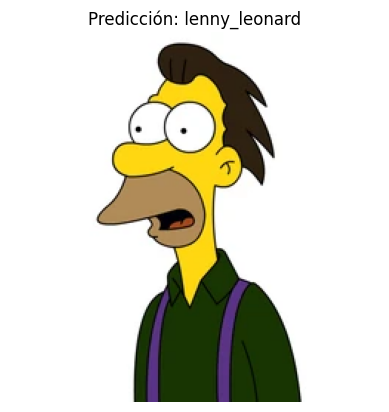

In [14]:


# Ruta a imagen nueva
imagen_path = "../data/leny.webp"

imagen = Image.open(imagen_path).convert("RGB")
imagen_tensor = transform(imagen).unsqueeze(0).to(device)  # [1, 3, 128, 128]

# Cargar modelo con la misma estructura
modelo_pred = resnet18(pretrained=False)
modelo_pred.fc = nn.Linear(modelo_pred.fc.in_features, num_classes)
modelo_pred.load_state_dict(torch.load("mejor_modelo_simpsons.pth"))
modelo_pred.to(device)
modelo_pred.eval()

# Predecir
with torch.no_grad():
    salida = modelo_pred(imagen_tensor)
    prediccion = torch.argmax(salida, dim=1).item()

# Mostrar resultado
clase_predicha = dataset.classes[prediccion]  # nombres reales desde ImageFolder
print(f"Personaje predicho: {clase_predicha}")

# Mostrar imagen
plt.imshow(imagen)
plt.axis("off")
plt.title(f"Predicción: {clase_predicha}")
plt.show()


Procesando...


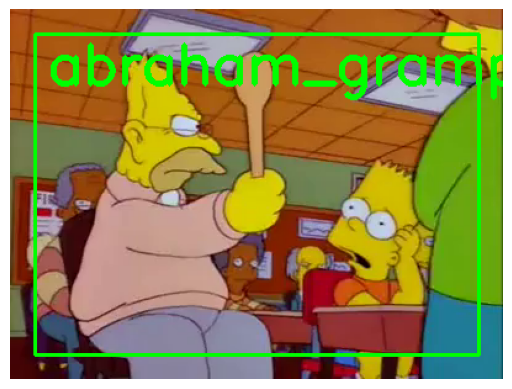

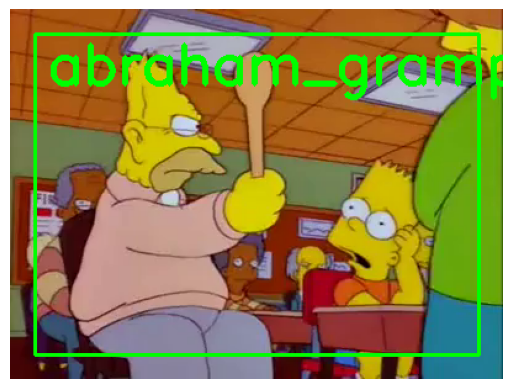

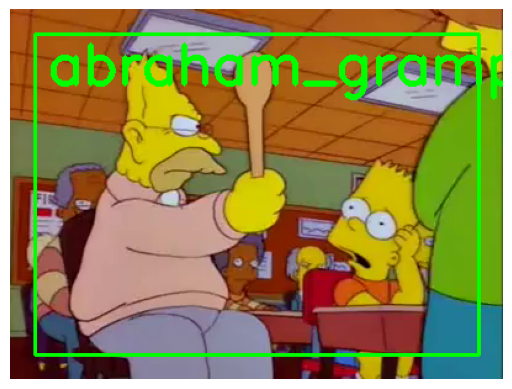

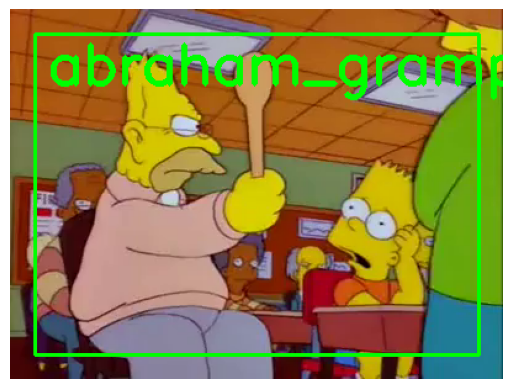

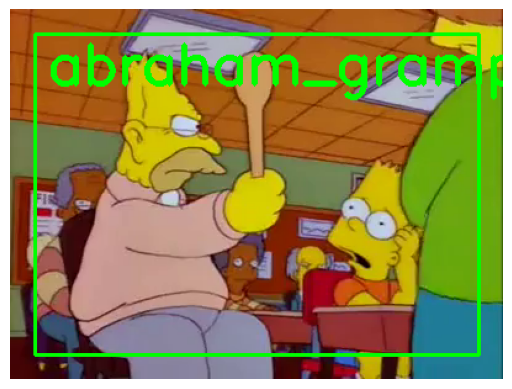

...

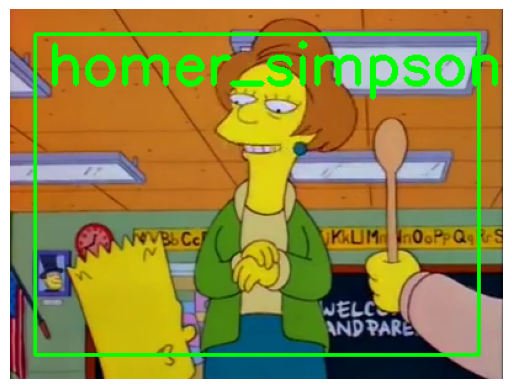

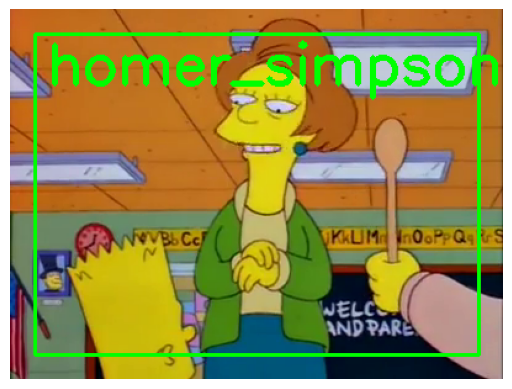

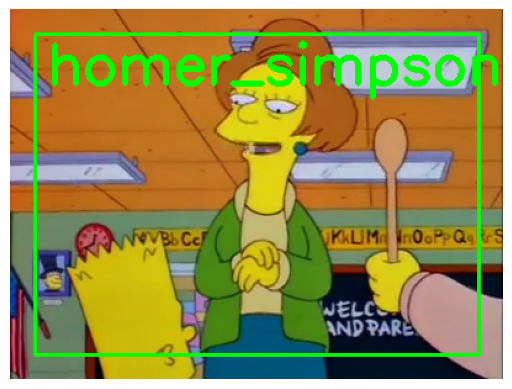

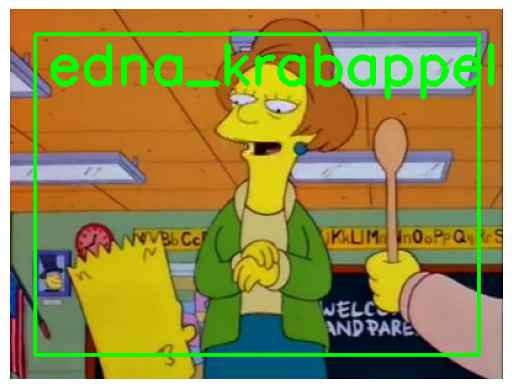

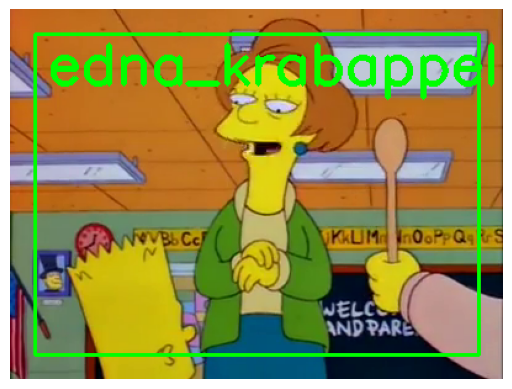

Terminado.


In [15]:
# Cargar modelo entrenado
modelo_video = resnet18(pretrained=False)
modelo_video.fc = nn.Linear(modelo_video.fc.in_features, num_classes)
modelo_video.load_state_dict(torch.load("mejor_modelo_simpsons.pth"))
modelo_video.to(device)
modelo_video.eval()

# Umbral de confianza
UMBRAL_CONFIANZA = 0.3

# Función para predecir un solo frame
def predecir_frame(frame):
    img_pil = Image.fromarray(cv2.cvtColor(frame, cv2.COLOR_BGR2RGB)).convert("RGB")
    img_tensor = transform(img_pil).unsqueeze(0).to(device)

    with torch.no_grad():
        salida = modelo_video(img_tensor)
        probs = torch.softmax(salida, dim=1)
        conf, pred = torch.max(probs, dim=1)

    clase = dataset.classes[pred.item()]
    confianza = conf.item()
    return clase, confianza

# Cargar video
video_path = "../data/tijiri.mp4"
cap = cv2.VideoCapture(video_path)

if not cap.isOpened():
    print("No se pudo abrir el video.")
else:
    print("Procesando...")
    for _ in range(100):  # Mostrar primeros 100 frames
        ret, frame = cap.read()
        if not ret:
            break

        clase, confianza = predecir_frame(frame)

        if confianza > UMBRAL_CONFIANZA:
            alto, ancho, _ = frame.shape
            color = (0, 255, 0)
            texto = f"{clase} ({confianza:.2f})"

            cv2.rectangle(frame, (20, 20), (ancho - 20, alto - 20), color, 2)
            cv2.putText(frame, texto, (30, 60), cv2.FONT_HERSHEY_SIMPLEX, 1.5, color, 3)

        # Mostrar
        frame_rgb = cv2.cvtColor(frame, cv2.COLOR_BGR2RGB)
        plt.imshow(frame_rgb)
        plt.axis("off")
        plt.show()

    cap.release()
    print("Terminado.")

In [16]:
# Hiperparámetros
EPOCHS = 25
LEARNING_RATE = 1e-5
patiencia = 5  # Early stopping si no mejora en 5 épocas

criterion = CrossEntropyLoss()
optimizer = Adam(modelo.parameters(), lr=LEARNING_RATE, weight_decay=1e-4)
scheduler = ReduceLROnPlateau(optimizer, mode='min', factor=0.5, patience=2, verbose=True)

mejor_loss_val = float('inf')
mejor_modelo = None
espera = 0

# Nombre único de archivo
timestamp = datetime.now().strftime("%Y%m%d_%H%M%S")
ruta_mejor_modelo = f"mejor_modelo_auto_{timestamp}.pth"

for epoch in range(EPOCHS):
    modelo.train()
    total_loss = 0

    for images, labels in train_loader:
        images, labels = images.to(device), labels.to(device)
        optimizer.zero_grad()
        outputs = modelo(images)
        loss = criterion(outputs, labels)
        loss.backward()
        optimizer.step()
        total_loss += loss.item()

    # Validación
    modelo.eval()
    val_loss = 0
    with torch.no_grad():
        for images, labels in val_loader:
            images, labels = images.to(device), labels.to(device)
            outputs = modelo(images)
            loss = criterion(outputs, labels)
            val_loss += loss.item()
    val_loss /= len(val_loader)

    print(f"Época {epoch+1}/{EPOCHS} - Pérdida entrenamiento: {total_loss/len(train_loader):.4f} - Pérdida validación: {val_loss:.4f}")
    scheduler.step(val_loss)

    # Checkpoint y Early Stopping
    if val_loss < mejor_loss_val:
        mejor_loss_val = val_loss
        mejor_modelo = copy.deepcopy(modelo.state_dict())
        espera = 0
        torch.save(mejor_modelo, ruta_mejor_modelo)
        print(f"✔️ Mejor modelo actualizado y guardado como {ruta_mejor_modelo}")
    else:
        espera += 1
        if espera >= paciencia:
            print("⏹️ Early stopping activado")
            break

# Cargar el mejor modelo automáticamente para evaluación
modelo.load_state_dict(torch.load(ruta_mejor_modelo))
modelo.eval()
print(f"Modelo cargado desde: {ruta_mejor_modelo}")

/opt/conda/lib/python3.10/site-packages/torch/optim/lr_scheduler.py:28: UserWarning: The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.
  warnings.warn("The verbose parameter is deprecated. Please use get_last_lr() "


Época 1/25 - Pérdida entrenamiento: 1.1507 - Pérdida validación: 1.3422
✔️ Mejor modelo actualizado y guardado como mejor_modelo_auto_20250517_035215.pth
Época 2/25 - Pérdida entrenamiento: 1.1439 - Pérdida validación: 1.3625
Época 3/25 - Pérdida entrenamiento: 1.1459 - Pérdida validación: 1.3725
Época 4/25 - Pérdida entrenamiento: 1.1376 - Pérdida validación: 1.3538
⏹️ Early stopping activado
Modelo cargado desde: mejor_modelo_auto_20250517_035215.pth


In [17]:
predicciones = []
etiquetas_reales = []

modelo.eval()
with torch.no_grad():
    for images, labels in val_loader:
        images, labels = images.to(device), labels.to(device)
        outputs = modelo(images)
        _, predicted = torch.max(outputs, 1)

        predicciones.extend(predicted.cpu().numpy())
        etiquetas_reales.extend(labels.cpu().numpy())

# Mostrar reporte de métricas
print(classification_report(etiquetas_reales, predicciones, target_names=dataset.classes))


                          precision    recall  f1-score   support

  abraham_grampa_simpson       0.68      0.64      0.66       197
           agnes_skinner       0.00      0.00      0.00        11
  apu_nahasapeemapetilon       0.82      0.82      0.82       121
           barney_gumble       1.00      0.17      0.29        24
            bart_simpson       0.65      0.65      0.65       251
            carl_carlson       0.89      0.38      0.53        21
charles_montgomery_burns       0.53      0.61      0.56       257
            chief_wiggum       0.65      0.72      0.69       189
         cletus_spuckler       1.00      0.33      0.50        12
          comic_book_guy       0.60      0.56      0.58        97
          edna_krabappel       0.63      0.56      0.59        87
    groundskeeper_willie       0.26      0.22      0.24        23
           homer_simpson       0.60      0.70      0.64       461
           kent_brockman       0.81      0.65      0.72       110
        k

/opt/conda/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1565: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/opt/conda/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1565: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/opt/conda/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1565: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Con resnet50

In [18]:
from torchvision.models import resnet50
import torchvision.transforms as transforms
import torch.nn as nn
import torch

# Asegurar que tienes el número correcto de clases
num_classes = len(dataset.classes)

# Cargar modelo preentrenado
modelo = resnet50(pretrained=True)
modelo.fc = nn.Linear(modelo.fc.in_features, num_classes)

# Opcional: Congelar todas las capas excepto layer4 y fc
for name, param in modelo.named_parameters():
    if not name.startswith("layer4") and "fc" not in name:
        param.requires_grad = False

# Enviar a GPU si está disponible
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
modelo.to(device)

# Transformación ajustada a ResNet50
transform = transforms.Compose([
    transforms.Resize((224, 224)),
    transforms.RandomHorizontalFlip(),
    transforms.RandomRotation(10),
    transforms.ColorJitter(brightness=0.2, contrast=0.2, saturation=0.2),
    transforms.ToTensor(),
    transforms.Normalize((0.5,), (0.5,))
])


/opt/conda/lib/python3.10/site-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=ResNet50_Weights.IMAGENET1K_V1`. You can also use `weights=ResNet50_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)
Downloading: "https://download.pytorch.org/models/resnet50-0676ba61.pth" to /root/.cache/torch/hub/checkpoints/resnet50-0676ba61.pth
100%|██████████| 97.8M/97.8M [00:01<00:00, 54.9MB/s]


In [19]:
# Hiperparámetros
EPOCHS = 25
LEARNING_RATE = 1e-5
patiencia = 5  # Early stopping si no mejora en 5 épocas

criterion = CrossEntropyLoss()
optimizer = Adam(modelo.parameters(), lr=LEARNING_RATE, weight_decay=1e-4)
scheduler = ReduceLROnPlateau(optimizer, mode='min', factor=0.5, patience=2, verbose=True)

mejor_loss_val = float('inf')
mejor_modelo = None
espera = 0

# Nombre único de archivo
timestamp = datetime.now().strftime("%Y%m%d_%H%M%S")
ruta_mejor_modelo = f"mejor_modelo_auto_{timestamp}.pth"

for epoch in range(EPOCHS):
    modelo.train()
    total_loss = 0

    for images, labels in train_loader:
        images, labels = images.to(device), labels.to(device)
        optimizer.zero_grad()
        outputs = modelo(images)
        loss = criterion(outputs, labels)
        loss.backward()
        optimizer.step()
        total_loss += loss.item()

    # Validación
    modelo.eval()
    val_loss = 0
    with torch.no_grad():
        for images, labels in val_loader:
            images, labels = images.to(device), labels.to(device)
            outputs = modelo(images)
            loss = criterion(outputs, labels)
            val_loss += loss.item()
    val_loss /= len(val_loader)

    print(f"Época {epoch+1}/{EPOCHS} - Pérdida entrenamiento: {total_loss/len(train_loader):.4f} - Pérdida validación: {val_loss:.4f}")
    scheduler.step(val_loss)

    # Checkpoint y Early Stopping
    if val_loss < mejor_loss_val:
        mejor_loss_val = val_loss
        mejor_modelo = copy.deepcopy(modelo.state_dict())
        espera = 0
        torch.save(mejor_modelo, ruta_mejor_modelo)
        print(f"✔️ Mejor modelo actualizado y guardado como {ruta_mejor_modelo}")
    else:
        espera += 1
        if espera >= paciencia:
            print("Early stopping activado")
            break

# Cargar el mejor modelo automáticamente para evaluación
modelo.load_state_dict(torch.load(ruta_mejor_modelo))
modelo.eval()
print(f"Modelo cargado desde: {ruta_mejor_modelo}")

/opt/conda/lib/python3.10/site-packages/torch/optim/lr_scheduler.py:28: UserWarning: The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.
  warnings.warn("The verbose parameter is deprecated. Please use get_last_lr() "


Época 1/25 - Pérdida entrenamiento: 2.2107 - Pérdida validación: 1.2855
✔️ Mejor modelo actualizado y guardado como mejor_modelo_auto_20250517_040316.pth
Época 2/25 - Pérdida entrenamiento: 0.9832 - Pérdida validación: 0.7991
✔️ Mejor modelo actualizado y guardado como mejor_modelo_auto_20250517_040316.pth
Época 3/25 - Pérdida entrenamiento: 0.6380 - Pérdida validación: 0.6146
✔️ Mejor modelo actualizado y guardado como mejor_modelo_auto_20250517_040316.pth
Época 4/25 - Pérdida entrenamiento: 0.4291 - Pérdida validación: 0.4916
✔️ Mejor modelo actualizado y guardado como mejor_modelo_auto_20250517_040316.pth
Época 5/25 - Pérdida entrenamiento: 0.2941 - Pérdida validación: 0.4383
✔️ Mejor modelo actualizado y guardado como mejor_modelo_auto_20250517_040316.pth
Época 6/25 - Pérdida entrenamiento: 0.2099 - Pérdida validación: 0.4044
✔️ Mejor modelo actualizado y guardado como mejor_modelo_auto_20250517_040316.pth
Época 7/25 - Pérdida entrenamiento: 0.1442 - Pérdida validación: 0.3810
✔️ M

In [20]:
predicciones = []
etiquetas_reales = []

modelo.eval()
with torch.no_grad():
    for images, labels in val_loader:
        images, labels = images.to(device), labels.to(device)
        outputs = modelo(images)
        _, predicted = torch.max(outputs, 1)

        predicciones.extend(predicted.cpu().numpy())
        etiquetas_reales.extend(labels.cpu().numpy())

# Mostrar reporte de métricas
print(classification_report(etiquetas_reales, predicciones, target_names=dataset.classes))

                          precision    recall  f1-score   support

  abraham_grampa_simpson       0.91      0.93      0.92       197
           agnes_skinner       0.83      0.45      0.59        11
  apu_nahasapeemapetilon       0.92      0.97      0.94       121
           barney_gumble       0.83      0.62      0.71        24
            bart_simpson       0.92      0.90      0.91       251
            carl_carlson       1.00      0.86      0.92        21
charles_montgomery_burns       0.94      0.89      0.91       257
            chief_wiggum       0.92      0.95      0.94       189
         cletus_spuckler       0.64      0.75      0.69        12
          comic_book_guy       0.89      0.90      0.89        97
          edna_krabappel       0.90      0.91      0.90        87
    groundskeeper_willie       0.81      0.74      0.77        23
           homer_simpson       0.92      0.94      0.93       461
           kent_brockman       0.98      0.95      0.97       110
        k

Predicción: bart_simpson (confianza: 0.78)


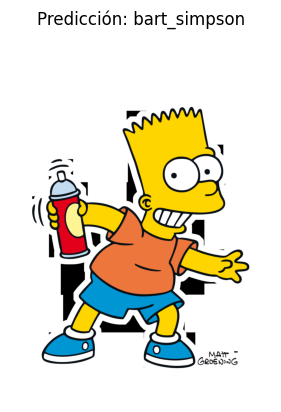

In [21]:

ruta_imagen = "../data/bart.png"

imagen = Image.open(ruta_imagen).convert("RGB")
imagen_tensor = transform(imagen).unsqueeze(0).to(device)

# Predecir
modelo.eval()
with torch.no_grad():
    salida = modelo(imagen_tensor)
    probabilidades = torch.softmax(salida, dim=1)
    confianza, pred_clase = torch.max(probabilidades, dim=1)

# Mostrar
clase = dataset.classes[pred_clase.item()]
print(f"Predicción: {clase} (confianza: {confianza.item():.2f})")

plt.imshow(imagen)
plt.title(f"Predicción: {clase}")
plt.axis("off")
plt.show()

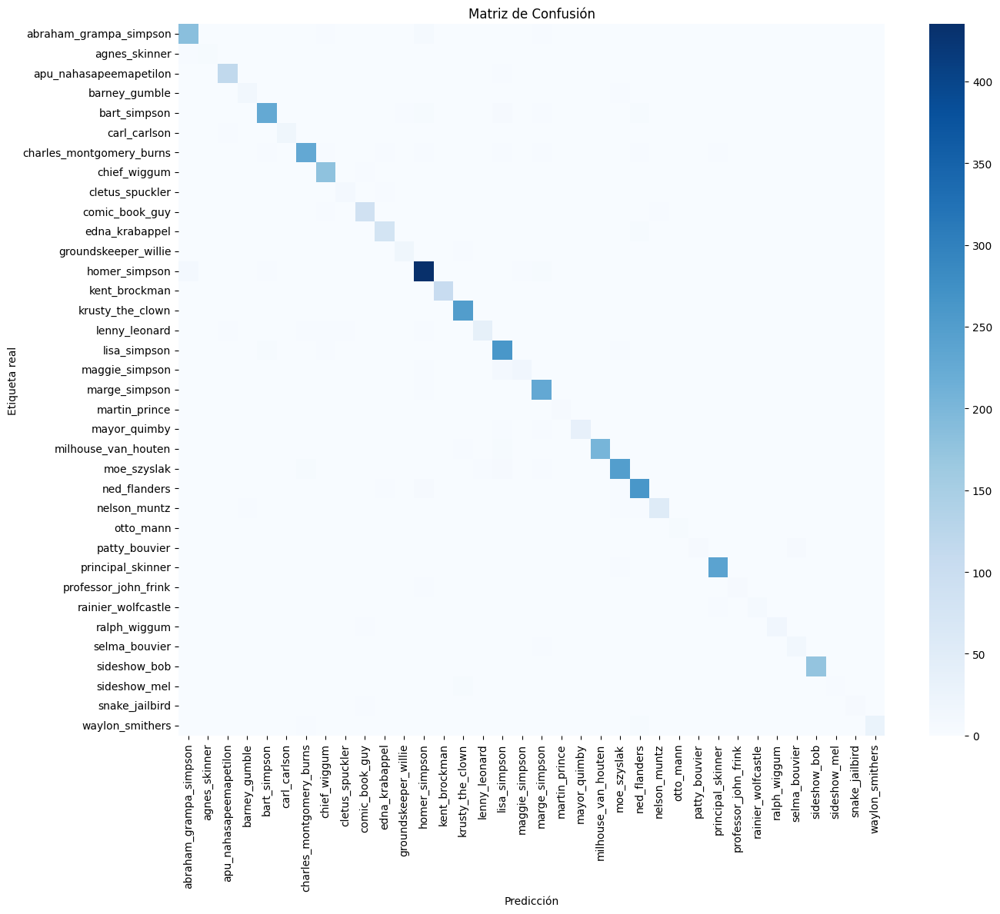

In [25]:
matriz = confusion_matrix(etiquetas_reales, predicciones)

# Crear mapa de calor con etiquetas
plt.figure(figsize=(14, 12))
sns.heatmap(matriz, xticklabels=dataset.classes, yticklabels=dataset.classes, 
            annot=False, fmt='d', cmap='Blues')

plt.xlabel("Predicción")
plt.ylabel("Etiqueta real")
plt.title("Matriz de Confusión")
plt.xticks(rotation=90)
plt.yticks(rotation=0)
plt.tight_layout()
plt.show()

In [31]:
total_size = len(dataset)
val_size = int(0.2 * total_size)
train_size = total_size - val_size
train_dataset, val_dataset = random_split(dataset, [train_size, val_size], generator=torch.Generator().manual_seed(42))
train_labels = [dataset.samples[i][1] for i in train_dataset.indices]
class_counts = Counter(train_labels)
class_weights = {cls: 1.0 / count for cls, count in class_counts.items()}
sample_weights = [class_weights[label] for label in train_labels]
sampler = WeightedRandomSampler(weights=sample_weights, num_samples=len(sample_weights), replacement=True)
train_loader = DataLoader(train_dataset, batch_size=32, sampler=sampler)
val_loader = DataLoader(val_dataset, batch_size=32, shuffle=False)

In [32]:
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
print("Dispositivo:", device)
#Hiperparámetros
EPOCHS = 25
LEARNING_RATE = 1e-5
patiencia = 5  # early stopping
peso_decay = 1e-4
timestamp = datetime.now().strftime("%Y%m%d_%H%M%S")
ruta_mejor_modelo = f"mejor_modelo_auto_{timestamp}.pth"

modelo = resnet50(weights=ResNet50_Weights.DEFAULT)
modelo.fc = torch.nn.Linear(modelo.fc.in_features, num_classes)  # Ajustar capa final
modelo = modelo.to(device)
criterion = CrossEntropyLoss()
optimizer = Adam(modelo.parameters(), lr=LEARNING_RATE, weight_decay=peso_decay)
scheduler = ReduceLROnPlateau(optimizer, mode='min', factor=0.5, patience=2, verbose=True)
mejor_loss_val = float('inf')
mejor_modelo = None
espera = 0

for epoch in range(EPOCHS):
    modelo.train()
    total_loss = 0

    for images, labels in train_loader:
        images, labels = images.to(device), labels.to(device)
        optimizer.zero_grad()
        outputs = modelo(images)
        loss = criterion(outputs, labels)
        loss.backward()
        optimizer.step()
        total_loss += loss.item()

    # Validación
    modelo.eval()
    val_loss = 0
    with torch.no_grad():
        for images, labels in val_loader:
            images, labels = images.to(device), labels.to(device)
            outputs = modelo(images)
            loss = criterion(outputs, labels)
            val_loss += loss.item()
    val_loss /= len(val_loader)

    print(f"Época {epoch+1}/{EPOCHS} - Pérdida entrenamiento: {total_loss/len(train_loader):.4f} - Pérdida validación: {val_loss:.4f}")
    scheduler.step(val_loss)

    # Checkpoint y Early stopping
    if val_loss < mejor_loss_val:
        mejor_loss_val = val_loss
        mejor_modelo = copy.deepcopy(modelo.state_dict())
        espera = 0
        torch.save(mejor_modelo, ruta_mejor_modelo)
        print(f"Mejor modelo actualizado y guardado como {ruta_mejor_modelo}")
    else:
        espera += 1
        if espera >= paciencia:
            print("Early stopping activado")
            break

modelo.load_state_dict(torch.load(ruta_mejor_modelo))
modelo.eval()
print(f"Modelo cargado desde: {ruta_mejor_modelo}")

Dispositivo: cuda


Downloading: "https://download.pytorch.org/models/resnet50-11ad3fa6.pth" to /root/.cache/torch/hub/checkpoints/resnet50-11ad3fa6.pth
100%|██████████| 97.8M/97.8M [00:04<00:00, 21.7MB/s]


Época 1/25 - Pérdida entrenamiento: 3.2483 - Pérdida validación: 3.0283
Mejor modelo actualizado y guardado como mejor_modelo_auto_20250517_063130.pth
Época 2/25 - Pérdida entrenamiento: 1.8144 - Pérdida validación: 1.4651
Mejor modelo actualizado y guardado como mejor_modelo_auto_20250517_063130.pth
Época 3/25 - Pérdida entrenamiento: 0.6817 - Pérdida validación: 0.6386
Mejor modelo actualizado y guardado como mejor_modelo_auto_20250517_063130.pth
Época 4/25 - Pérdida entrenamiento: 0.3108 - Pérdida validación: 0.4298
Mejor modelo actualizado y guardado como mejor_modelo_auto_20250517_063130.pth
Época 5/25 - Pérdida entrenamiento: 0.1775 - Pérdida validación: 0.3420
Mejor modelo actualizado y guardado como mejor_modelo_auto_20250517_063130.pth
Época 6/25 - Pérdida entrenamiento: 0.1159 - Pérdida validación: 0.2808
Mejor modelo actualizado y guardado como mejor_modelo_auto_20250517_063130.pth
Época 7/25 - Pérdida entrenamiento: 0.0798 - Pérdida validación: 0.2625
Mejor modelo actualiza

In [33]:
predicciones = []
etiquetas_reales = []

modelo.eval()
with torch.no_grad():
    for images, labels in val_loader:
        images, labels = images.to(device), labels.to(device)
        outputs = modelo(images)
        _, predicted = torch.max(outputs, 1)

        predicciones.extend(predicted.cpu().numpy())
        etiquetas_reales.extend(labels.cpu().numpy())

# Mostrar reporte de métricas
print(classification_report(etiquetas_reales, predicciones, target_names=dataset.classes))

                          precision    recall  f1-score   support

  abraham_grampa_simpson       0.96      0.98      0.97       179
           agnes_skinner       0.89      1.00      0.94         8
  apu_nahasapeemapetilon       0.99      0.97      0.98       112
           barney_gumble       0.92      0.72      0.81        32
            bart_simpson       0.99      0.96      0.97       264
            carl_carlson       0.96      0.96      0.96        24
charles_montgomery_burns       0.96      0.96      0.96       245
            chief_wiggum       0.98      0.98      0.98       212
         cletus_spuckler       1.00      0.70      0.82        10
          comic_book_guy       0.93      0.92      0.92        86
          edna_krabappel       0.92      0.98      0.95        83
    groundskeeper_willie       0.74      0.96      0.84        24
           homer_simpson       0.96      0.92      0.94       430
           kent_brockman       0.97      0.98      0.97       119
        k

Predicción: lisa_simpson (confianza: 0.57)


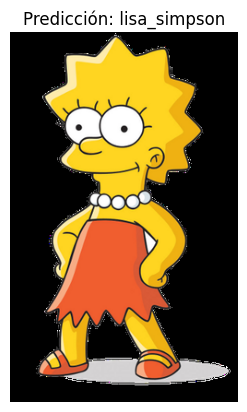

In [34]:
ruta_imagen = "../data/Lisa.png"

imagen = Image.open(ruta_imagen).convert("RGB")
imagen_tensor = transform(imagen).unsqueeze(0).to(device)

# Predecir
modelo.eval()
with torch.no_grad():
    salida = modelo(imagen_tensor)
    probabilidades = torch.softmax(salida, dim=1)
    confianza, pred_clase = torch.max(probabilidades, dim=1)

# Mostrar
clase = dataset.classes[pred_clase.item()]
print(f"Predicción: {clase} (confianza: {confianza.item():.2f})")

plt.imshow(imagen)
plt.title(f"Predicción: {clase}")
plt.axis("off")
plt.show()

Predicción: bart_simpson (confianza: 0.64)


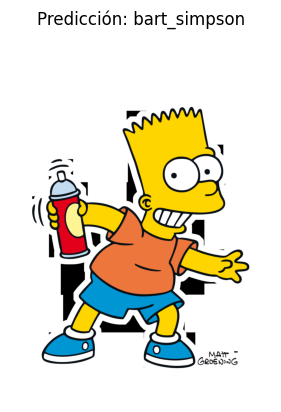

In [35]:

ruta_imagen = "../data/bart.png"

imagen = Image.open(ruta_imagen).convert("RGB")
imagen_tensor = transform(imagen).unsqueeze(0).to(device)

# Predecir
modelo.eval()
with torch.no_grad():
    salida = modelo(imagen_tensor)
    probabilidades = torch.softmax(salida, dim=1)
    confianza, pred_clase = torch.max(probabilidades, dim=1)

# Mostrar
clase = dataset.classes[pred_clase.item()]
print(f"Predicción: {clase} (confianza: {confianza.item():.2f})")

plt.imshow(imagen)
plt.title(f"Predicción: {clase}")
plt.axis("off")
plt.show()

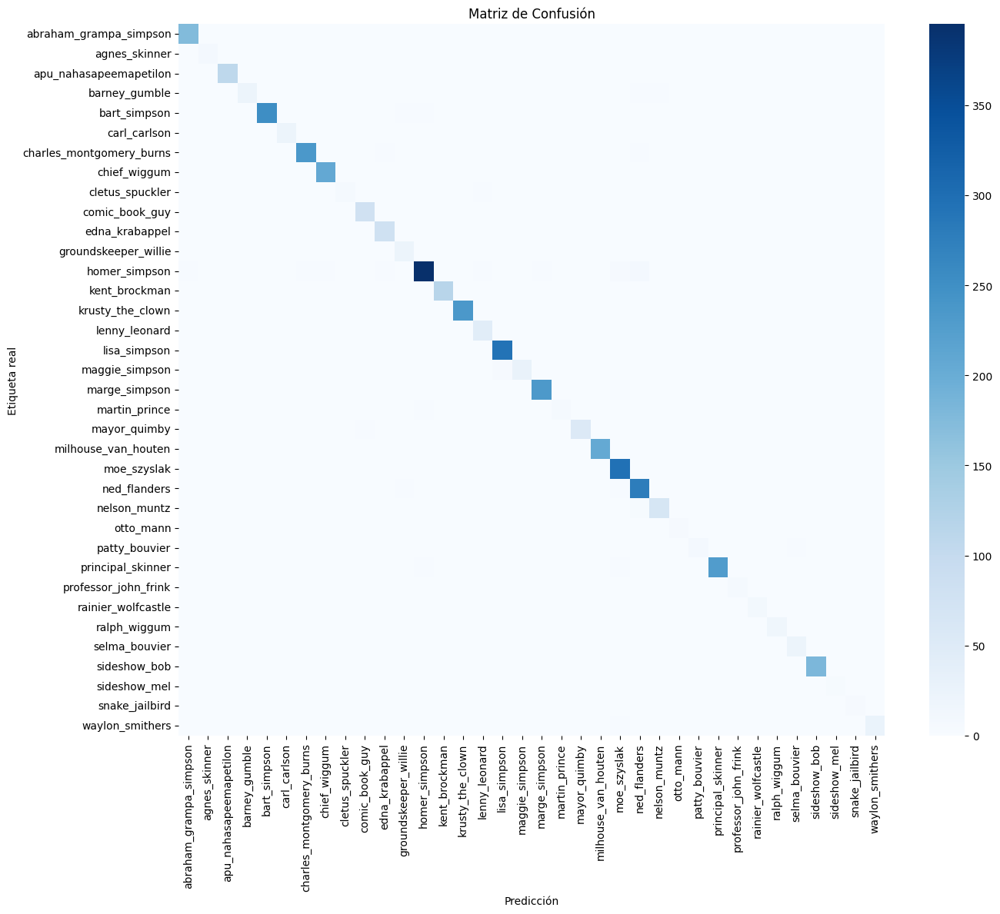

In [36]:
matriz = confusion_matrix(etiquetas_reales, predicciones)

# Crear mapa de calor con etiquetas
plt.figure(figsize=(14, 12))
sns.heatmap(matriz, xticklabels=dataset.classes, yticklabels=dataset.classes, 
            annot=False, fmt='d', cmap='Blues')

plt.xlabel("Predicción")
plt.ylabel("Etiqueta real")
plt.title("Matriz de Confusión")
plt.xticks(rotation=90)
plt.yticks(rotation=0)
plt.tight_layout()
plt.show()

Procesando...


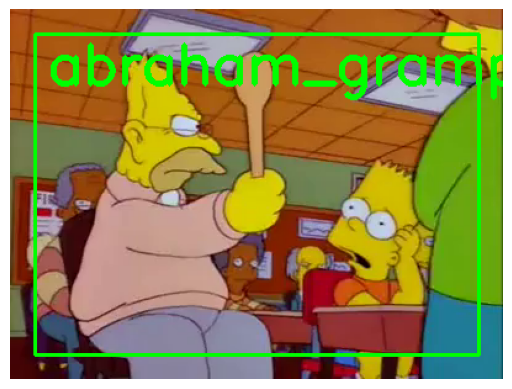

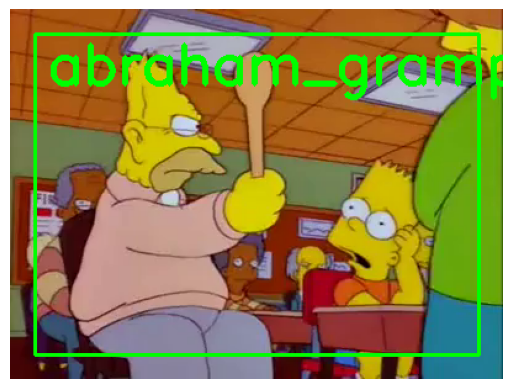

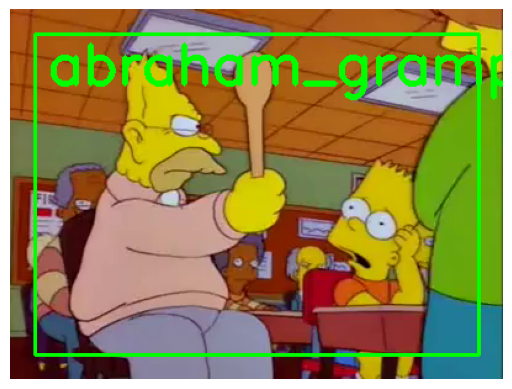

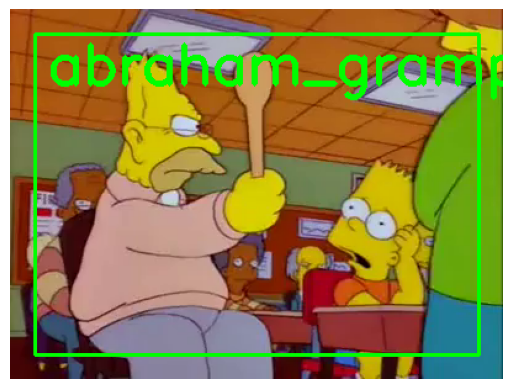

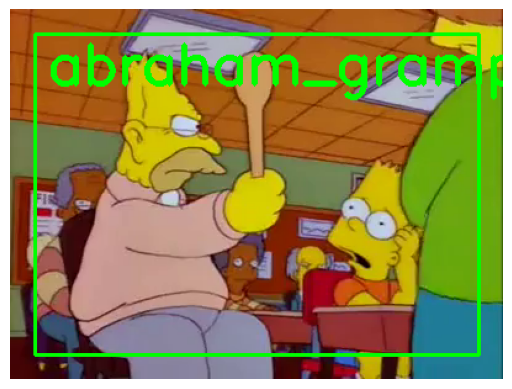

...

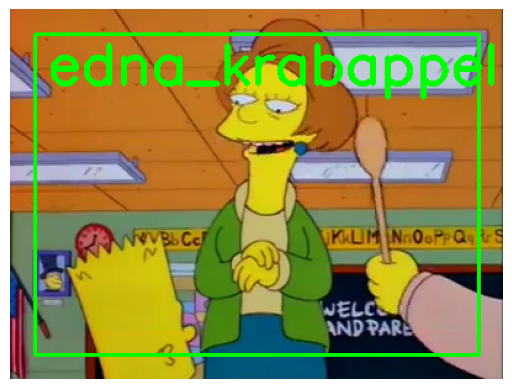

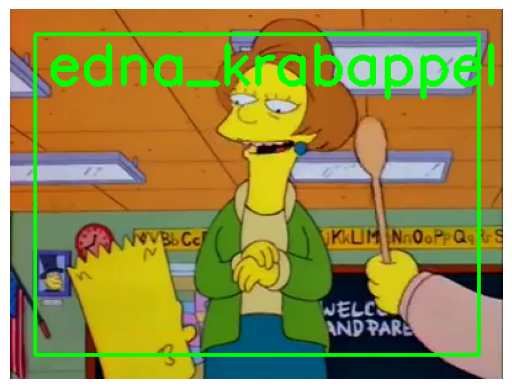

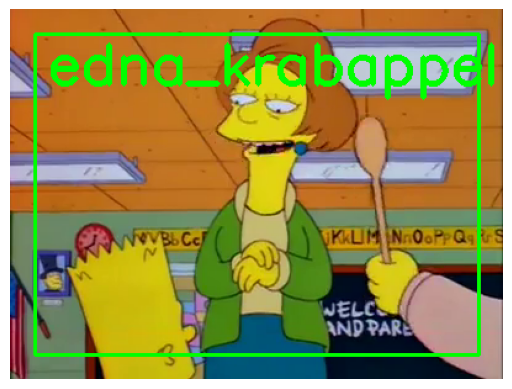

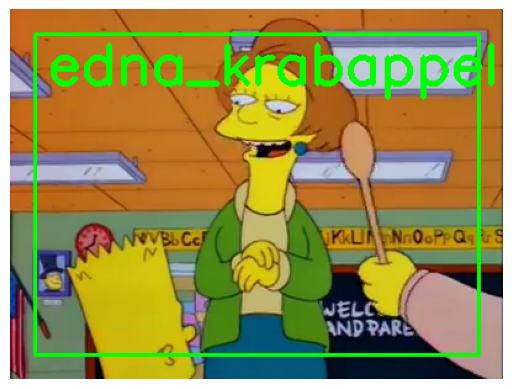

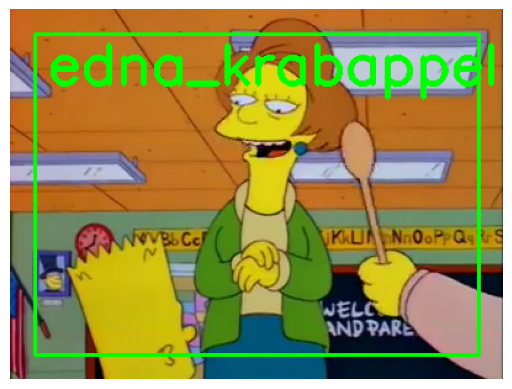

Terminado.


In [38]:
modelo_video = resnet50(pretrained=False)
modelo_video.fc = nn.Linear(modelo_video.fc.in_features, num_classes)
modelo_video.load_state_dict(torch.load("mejor_modelo_auto_20250517_063130.pth"))
modelo_video.to(device)
modelo_video.eval()

# Umbral de confianza
UMBRAL_CONFIANZA = 0.3

# Función para predecir un solo frame
def predecir_frame(frame):
    img_pil = Image.fromarray(cv2.cvtColor(frame, cv2.COLOR_BGR2RGB)).convert("RGB")
    img_tensor = transform(img_pil).unsqueeze(0).to(device)

    with torch.no_grad():
        salida = modelo_video(img_tensor)
        probs = torch.softmax(salida, dim=1)
        conf, pred = torch.max(probs, dim=1)

    clase = dataset.classes[pred.item()]
    confianza = conf.item()
    return clase, confianza

# Cargar video
video_path = "../data/tijiri.mp4"
cap = cv2.VideoCapture(video_path)

if not cap.isOpened():
    print("No se pudo abrir el video.")
else:
    print("Procesando...")
    for _ in range(50):  # Cambiar pal numero de frames q quiera, empieza desde el principio
        ret, frame = cap.read()
        if not ret:
            break

        clase, confianza = predecir_frame(frame)

        if confianza > UMBRAL_CONFIANZA:
            alto, ancho, _ = frame.shape
            color = (0, 255, 0)
            texto = f"{clase} ({confianza:.2f})"

            cv2.rectangle(frame, (20, 20), (ancho - 20, alto - 20), color, 2)
            cv2.putText(frame, texto, (30, 60), cv2.FONT_HERSHEY_SIMPLEX, 1.5, color, 3)

        frame_rgb = cv2.cvtColor(frame, cv2.COLOR_BGR2RGB)
        plt.imshow(frame_rgb)
        plt.axis("off")
        plt.show()

    cap.release()
    print("Terminado.")

Procesando...


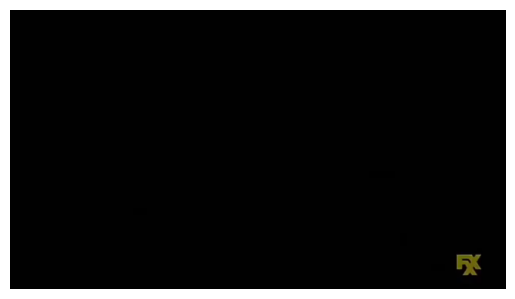

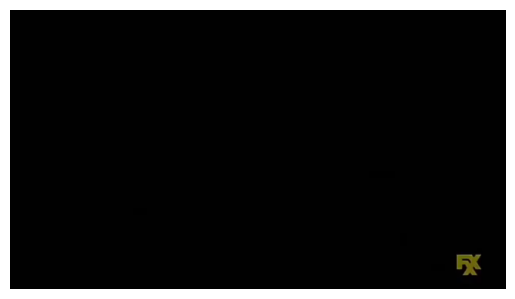

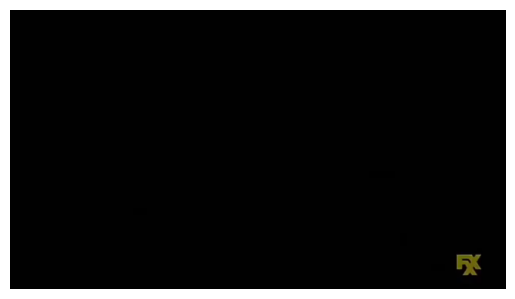

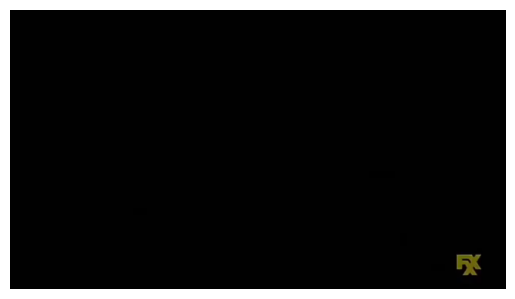

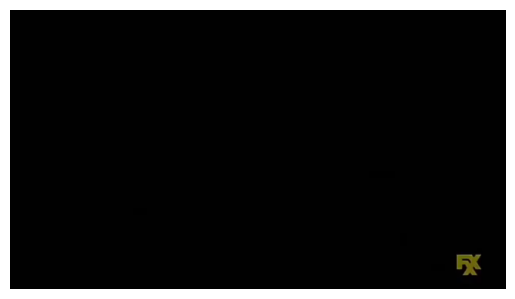

...

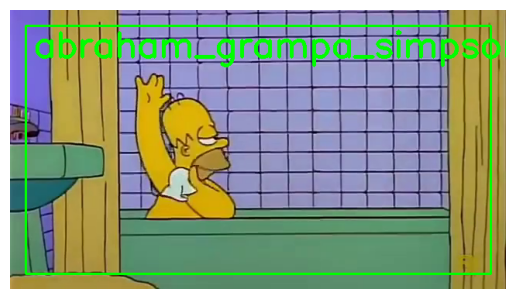

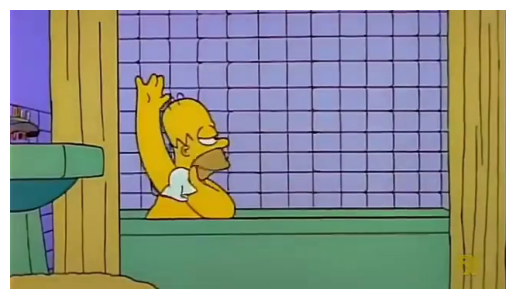

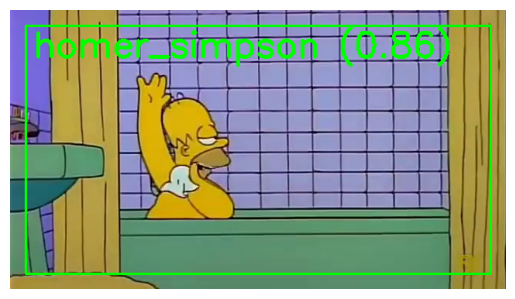

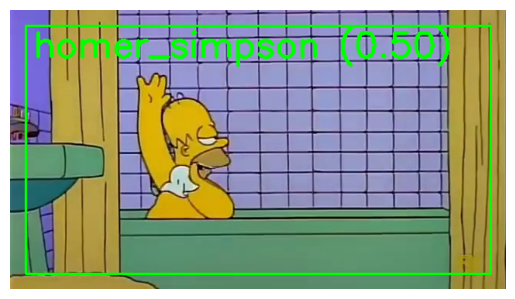

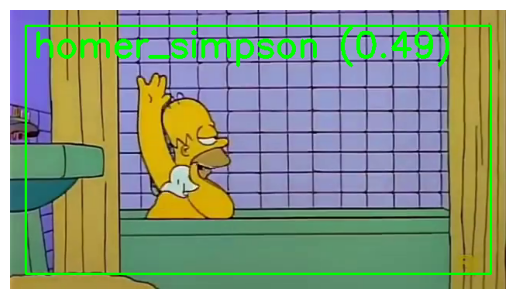

Terminado.


In [39]:
modelo_video = resnet50(pretrained=False)
modelo_video.fc = nn.Linear(modelo_video.fc.in_features, num_classes)
modelo_video.load_state_dict(torch.load("mejor_modelo_auto_20250517_063130.pth"))
modelo_video.to(device)
modelo_video.eval()

# Umbral de confianza
UMBRAL_CONFIANZA = 0.3

# Función para predecir un solo frame
def predecir_frame(frame):
    img_pil = Image.fromarray(cv2.cvtColor(frame, cv2.COLOR_BGR2RGB)).convert("RGB")
    img_tensor = transform(img_pil).unsqueeze(0).to(device)

    with torch.no_grad():
        salida = modelo_video(img_tensor)
        probs = torch.softmax(salida, dim=1)
        conf, pred = torch.max(probs, dim=1)

    clase = dataset.classes[pred.item()]
    confianza = conf.item()
    return clase, confianza

# Cargar video
video_path = "../data/pajarapinta.mp4"
cap = cv2.VideoCapture(video_path)

if not cap.isOpened():
    print("No se pudo abrir el video.")
else:
    print("Procesando...")
    for _ in range(50):  # Cambiar pal numero de frames q quiera, empieza desde el principio
        ret, frame = cap.read()
        if not ret:
            break

        clase, confianza = predecir_frame(frame)

        if confianza > UMBRAL_CONFIANZA:
            alto, ancho, _ = frame.shape
            color = (0, 255, 0)
            texto = f"{clase} ({confianza:.2f})"

            cv2.rectangle(frame, (20, 20), (ancho - 20, alto - 20), color, 2)
            cv2.putText(frame, texto, (30, 60), cv2.FONT_HERSHEY_SIMPLEX, 1.5, color, 3)

        frame_rgb = cv2.cvtColor(frame, cv2.COLOR_BGR2RGB)
        plt.imshow(frame_rgb)
        plt.axis("off")
        plt.show()

    cap.release()
    print("Terminado.")

Predicción: barney_gumble (confianza: 0.79)


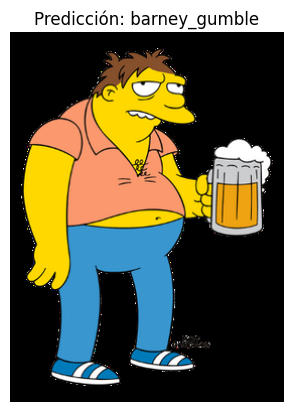

In [40]:

ruta_imagen = "../data/Barney.png"

imagen = Image.open(ruta_imagen).convert("RGB")
imagen_tensor = transform(imagen).unsqueeze(0).to(device)

# Predecir
modelo.eval()
with torch.no_grad():
    salida = modelo(imagen_tensor)
    probabilidades = torch.softmax(salida, dim=1)
    confianza, pred_clase = torch.max(probabilidades, dim=1)

# Mostrar
clase = dataset.classes[pred_clase.item()]
print(f"Predicción: {clase} (confianza: {confianza.item():.2f})")

plt.imshow(imagen)
plt.title(f"Predicción: {clase}")
plt.axis("off")
plt.show()